In [1]:
#import important libraries
import pandas as pd
import seaborn as sns
import numpy as np
import matplotlib.pyplot as plt
import plotly.express as px
import plotly.graph_objects as go
from IPython .display import HTML, display

In [2]:
athletes = pd.read_csv('B:/Datasets/athlete_events.csv')
regions = pd.read_csv('B:/Datasets/noc_regions.csv')

In [3]:
athletes.head()

,ID,Name,Sex,Age,Height,Weight,Team,NOC,Games,Year,Season,City,Sport,Event,Medal
0,1,A Dijiang,M,24.0,180.0,80.0,China,CHN,1992 Summer,1992,Summer,Barcelona,Basketball,Basketball Men's Basketball,NaN
1,2,A Lamusi,M,23.0,170.0,60.0,China,CHN,2012 Summer,2012,Summer,London,Judo,Judo Men's Extra-Lightweight,NaN
2,3,Gunnar Nielsen Aaby,M,24.0,NaN,NaN,Denmark,DEN,1920 Summer,1920,Summer,Antwerpen,Football,Football Men's Football,NaN
3,4,Edgar Lindenau Aabye,M,34.0,NaN,NaN,Denmark/Sweden,DEN,1900 Summer,1900,Summer,Paris,Tug-Of-War,Tug-Of-War Men's Tug-Of-War,Gold
4,5,Christine Jacoba Aaftink,F,21.0,185.0,82.0,Netherlands,NED,1988 Winter,1988,Winter,Calgary,Speed Skating,Speed Skating Women's 500 metres,NaN


In [4]:
regions.head()

,NOC,region,notes
0,AFG,Afghanistan,NaN
1,AHO,Curacao,Netherlands Antilles
2,ALB,Albania,NaN
3,ALG,Algeria,NaN
4,AND,Andorra,NaN


In [5]:
athletes_df = athletes.merge(regions, how = 'left', on = 'NOC')
athletes_df.head()

,ID,Name,Sex,Age,Height,Weight,Team,NOC,Games,Year,Season,City,Sport,Event,Medal,region,notes
0,1,A Dijiang,M,24.0,180.0,80.0,China,CHN,1992 Summer,1992,Summer,Barcelona,Basketball,Basketball Men's Basketball,NaN,China,NaN
1,2,A Lamusi,M,23.0,170.0,60.0,China,CHN,2012 Summer,2012,Summer,London,Judo,Judo Men's Extra-Lightweight,NaN,China,NaN
2,3,Gunnar Nielsen Aaby,M,24.0,NaN,NaN,Denmark,DEN,1920 Summer,1920,Summer,Antwerpen,Football,Football Men's Football,NaN,Denmark,NaN
3,4,Edgar Lindenau Aabye,M,34.0,NaN,NaN,Denmark/Sweden,DEN,1900 Summer,1900,Summer,Paris,Tug-Of-War,Tug-Of-War Men's Tug-Of-War,Gold,Denmark,NaN
4,5,Christine Jacoba Aaftink,F,21.0,185.0,82.0,Netherlands,NED,1988 Winter,1988,Winter,Calgary,Speed Skating,Speed Skating Women's 500 metres,NaN,Netherlands,NaN


In [6]:
#check the shape of dataset 
athletes_df.shape

(271116, 17)

In [7]:
#lets make Column names more consistence
athletes_df.rename(columns={'region': 'Region', 'notes':'Notes'}, inplace=True)
athletes_df.head()

,ID,Name,Sex,Age,Height,Weight,Team,NOC,Games,Year,Season,City,Sport,Event,Medal,Region,Notes
0,1,A Dijiang,M,24.0,180.0,80.0,China,CHN,1992 Summer,1992,Summer,Barcelona,Basketball,Basketball Men's Basketball,NaN,China,NaN
1,2,A Lamusi,M,23.0,170.0,60.0,China,CHN,2012 Summer,2012,Summer,London,Judo,Judo Men's Extra-Lightweight,NaN,China,NaN
2,3,Gunnar Nielsen Aaby,M,24.0,NaN,NaN,Denmark,DEN,1920 Summer,1920,Summer,Antwerpen,Football,Football Men's Football,NaN,Denmark,NaN
3,4,Edgar Lindenau Aabye,M,34.0,NaN,NaN,Denmark/Sweden,DEN,1900 Summer,1900,Summer,Paris,Tug-Of-War,Tug-Of-War Men's Tug-Of-War,Gold,Denmark,NaN
4,5,Christine Jacoba Aaftink,F,21.0,185.0,82.0,Netherlands,NED,1988 Winter,1988,Winter,Calgary,Speed Skating,Speed Skating Women's 500 metres,NaN,Netherlands,NaN


In [8]:
#some information about dataset
athletes_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 271116 entries, 0 to 271115
Data columns (total 17 columns):
 #   Column  Non-Null Count   Dtype  
---  ------  --------------   -----  
 0   ID      271116 non-null  int64  
 1   Name    271116 non-null  object 
 2   Sex     271116 non-null  object 
 3   Age     261642 non-null  float64
 4   Height  210945 non-null  float64
 5   Weight  208241 non-null  float64
 6   Team    271116 non-null  object 
 7   NOC     271116 non-null  object 
 8   Games   271116 non-null  object 
 9   Year    271116 non-null  int64  
 10  Season  271116 non-null  object 
 11  City    271116 non-null  object 
 12  Sport   271116 non-null  object 
 13  Event   271116 non-null  object 
 14  Medal   39783 non-null   object 
 15  Region  270746 non-null  object 
 16  Notes   5039 non-null    object 
dtypes: float64(3), int64(2), object(12)
memory usage: 37.2+ MB


In [9]:
athletes_df.describe()

,ID,Age,Height,Weight,Year
count,271116.000000,261642.000000,210945.000000,208241.000000,271116.000000
mean,68248.954396,25.556898,175.338970,70.702393,1978.378480
std,39022.286345,6.393561,10.518462,14.348020,29.877632
min,1.000000,10.000000,127.000000,25.000000,1896.000000
25%,34643.000000,21.000000,168.000000,60.000000,1960.000000
50%,68205.000000,24.000000,175.000000,70.000000,1988.000000
75%,102097.250000,28.000000,183.000000,79.000000,2002.000000
max,135571.000000,97.000000,226.000000,214.000000,2016.000000


In [10]:
#lets check null value present in columns 
nan_values = athletes_df.isna()
nan_columns = nan_values.any()
nan_columns

ID        False
Name      False
Sex       False
Age        True
Height     True
Weight     True
Team      False
NOC       False
Games     False
Year      False
Season    False
City      False
Sport     False
Event     False
Medal      True
Region     True
Notes      True
dtype: bool

As we can see there are 6 columns which contains the null values

In [11]:
athletes_df.isnull().sum()

ID             0
Name           0
Sex            0
Age         9474
Height     60171
Weight     62875
Team           0
NOC            0
Games          0
Year           0
Season         0
City           0
Sport          0
Event          0
Medal     231333
Region       370
Notes     266077
dtype: int64

In [12]:
athletes_df.columns[athletes_df.isna().any()].tolist()

['Age', 'Height', 'Weight', 'Medal', 'Region', 'Notes']

In [13]:
#lets check the details about india
athletes_df.query('Team == "India"').tail()

,ID,Name,Sex,Age,Height,Weight,Team,NOC,Games,Year,Season,City,Sport,Event,Medal,Region,Notes
264139,132177,Mohammad Anas Yahiya,M,21.0,177.0,69.0,India,IND,2016 Summer,2016,Summer,Rio de Janeiro,Athletics,Athletics Men's 4 x 400 metres Relay,NaN,India,NaN
265876,133029,"Thyadathuvilla Chandrapillai ""T. C."" Yohannan",M,29.0,174.0,62.0,India,IND,1976 Summer,1976,Summer,Montreal,Athletics,Athletics Men's Long Jump,NaN,India,NaN
266934,133554,Sayed Muhammad Yusuf,M,NaN,NaN,NaN,India,IND,1928 Summer,1928,Summer,Amsterdam,Hockey,Hockey Men's Hockey,Gold,India,NaN
270912,135480,Geeta Zutshi,F,23.0,167.0,51.0,India,IND,1980 Summer,1980,Summer,Moskva,Athletics,Athletics Women's 800 metres,NaN,India,NaN
270913,135480,Geeta Zutshi,F,27.0,167.0,51.0,India,IND,1984 Summer,1984,Summer,Los Angeles,Athletics,"Athletics Women's 3,000 metres",NaN,India,NaN


In [14]:
#Top 10 Countries in terms of participants
top10_countries = athletes_df.Team.value_counts().sort_values(ascending=False).head(10)
top10_countries

United States    17847
France           11988
Great Britain    11404
Italy            10260
Germany           9326
Canada            9279
Japan             8289
Sweden            8052
Australia         7513
Hungary           6547
Name: Team, dtype: int64

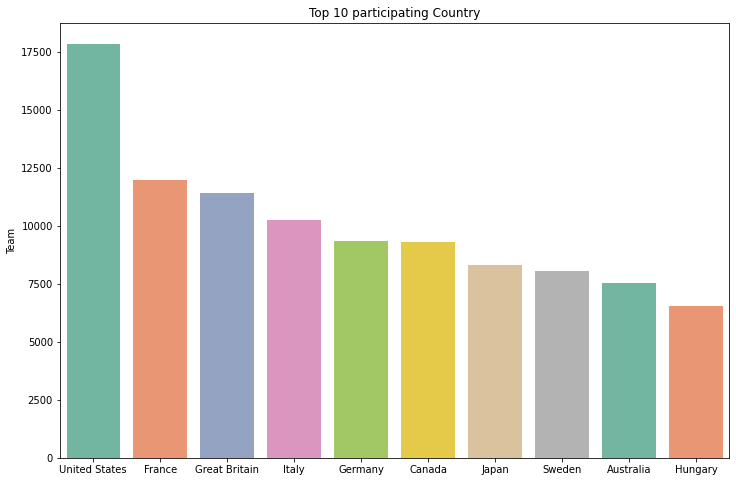

In [15]:
plt.figure(figsize=(12,8))
plt.title("Top 10 participating Country")
sns.barplot(x=top10_countries.index, y=top10_countries, palette='Set2');

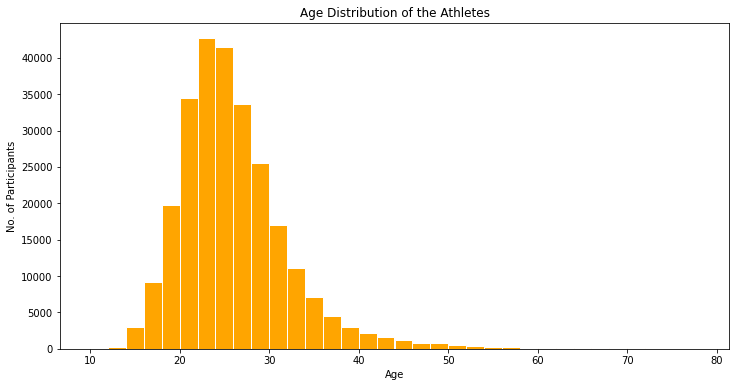

In [16]:
#Checking how age is distributed across participants 
plt.figure(figsize=(12,6))
plt.title("Age Distribution of the Athletes")
plt.xlabel("Age")
plt.ylabel("No. of Participants")
plt.hist(athletes_df.Age, bins=np.arange(10,80,2), color='orange', edgecolor='white');

#### Checking the sports Played during different season

In [17]:
winter_sports = athletes_df[athletes_df.Season == 'Winter'].Sport.unique()
winter_sports

array(['Speed Skating', 'Cross Country Skiing', 'Ice Hockey', 'Biathlon',
       'Alpine Skiing', 'Luge', 'Bobsleigh', 'Figure Skating',
       'Nordic Combined', 'Freestyle Skiing', 'Ski Jumping', 'Curling',
       'Snowboarding', 'Short Track Speed Skating', 'Skeleton',
       'Military Ski Patrol', 'Alpinism'], dtype=object)

In [18]:
summer_sports = athletes_df[athletes_df.Season == 'Summer'].Sport.unique()
summer_sports

array(['Basketball', 'Judo', 'Football', 'Tug-Of-War', 'Athletics',
       'Swimming', 'Badminton', 'Sailing', 'Gymnastics',
       'Art Competitions', 'Handball', 'Weightlifting', 'Wrestling',
       'Water Polo', 'Hockey', 'Rowing', 'Fencing', 'Equestrianism',
       'Shooting', 'Boxing', 'Taekwondo', 'Cycling', 'Diving', 'Canoeing',
       'Tennis', 'Modern Pentathlon', 'Golf', 'Softball', 'Archery',
       'Volleyball', 'Synchronized Swimming', 'Table Tennis', 'Baseball',
       'Rhythmic Gymnastics', 'Rugby Sevens', 'Trampolining',
       'Beach Volleyball', 'Triathlon', 'Rugby', 'Lacrosse', 'Polo',
       'Cricket', 'Ice Hockey', 'Racquets', 'Motorboating', 'Croquet',
       'Figure Skating', 'Jeu De Paume', 'Roque', 'Basque Pelota',
       'Alpinism', 'Aeronautics'], dtype=object)

## Male and Female Participants


In [19]:
gender_counts = athletes_df.Sex.value_counts()
gender_counts

M    196594
F     74522
Name: Sex, dtype: int64

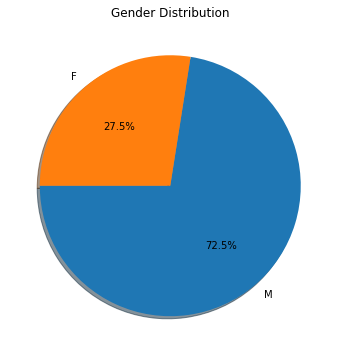

In [20]:
plt.figure(figsize=(12,6))
plt.title("Gender Distribution")
plt.pie(gender_counts, labels=gender_counts.index, autopct='%1.1f%%',startangle=180, shadow=True);

In [21]:
athletes_df.Medal.value_counts()

Gold      13372
Bronze    13295
Silver    13116
Name: Medal, dtype: int64

In [22]:
female_participants = athletes_df[(athletes_df.Sex=='F')&(athletes_df.Season=='Summer')][['Sex', 'Year']]
female_participants = female_participants.groupby('Year').count().reset_index()
female_participants.tail()

,Year,Sex
23,2000,5431
24,2004,5546
25,2008,5816
26,2012,5815
27,2016,6223


In [23]:
womenOlympics = athletes_df[(athletes_df.Sex == 'F') & (athletes_df.Season == 'Summer')]

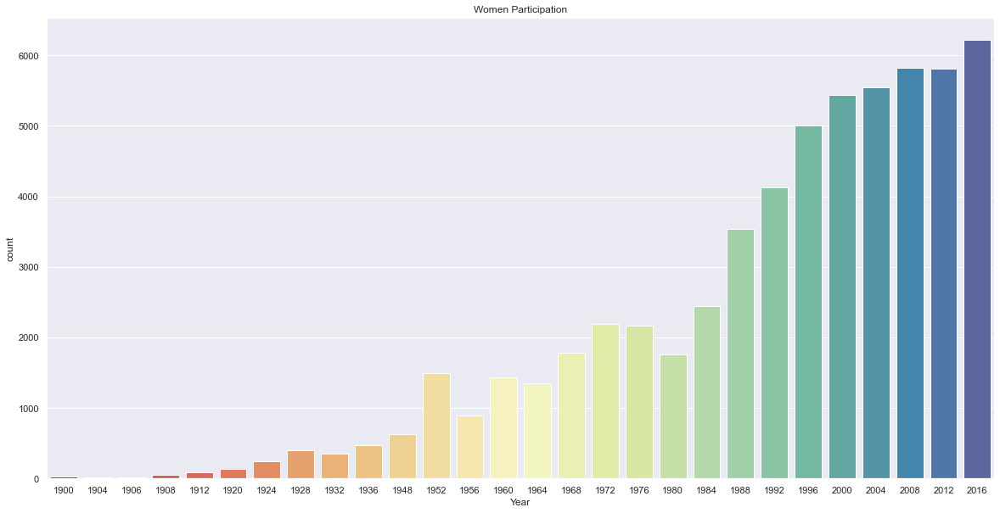

In [24]:
sns.set(style="darkgrid")
plt.figure(figsize=(20, 10))
sns.countplot(x='Year', data=womenOlympics, palette='Spectral')
plt.title('Women Participation');


Text(0.5, 1.0, 'Plot of Female Athletes Over Time')

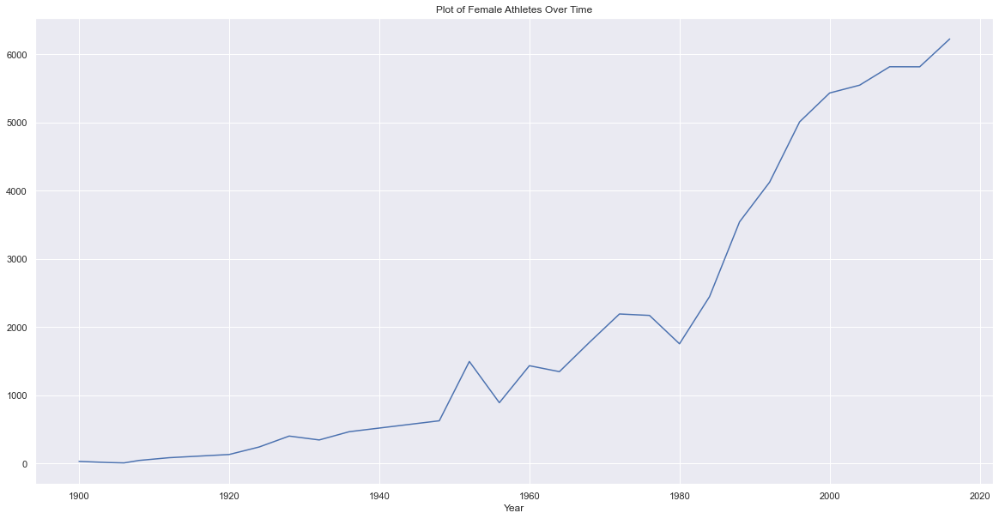

In [25]:
part = womenOlympics.groupby('Year')['Sex'].value_counts()
plt.figure(figsize=(20, 10))
part.loc[:,'F'].plot()
plt.title('Plot of Female Athletes Over Time')

In [26]:
goldMedals = athletes_df[(athletes_df.Medal == "Gold")]
goldMedals.head()

,ID,Name,Sex,Age,Height,Weight,Team,NOC,Games,Year,Season,City,Sport,Event,Medal,Region,Notes
3,4,Edgar Lindenau Aabye,M,34.0,NaN,NaN,Denmark/Sweden,DEN,1900 Summer,1900,Summer,Paris,Tug-Of-War,Tug-Of-War Men's Tug-Of-War,Gold,Denmark,NaN
42,17,Paavo Johannes Aaltonen,M,28.0,175.0,64.0,Finland,FIN,1948 Summer,1948,Summer,London,Gymnastics,Gymnastics Men's Team All-Around,Gold,Finland,NaN
44,17,Paavo Johannes Aaltonen,M,28.0,175.0,64.0,Finland,FIN,1948 Summer,1948,Summer,London,Gymnastics,Gymnastics Men's Horse Vault,Gold,Finland,NaN
48,17,Paavo Johannes Aaltonen,M,28.0,175.0,64.0,Finland,FIN,1948 Summer,1948,Summer,London,Gymnastics,Gymnastics Men's Pommelled Horse,Gold,Finland,NaN
60,20,Kjetil Andr Aamodt,M,20.0,176.0,85.0,Norway,NOR,1992 Winter,1992,Winter,Albertville,Alpine Skiing,Alpine Skiing Men's Super G,Gold,Norway,NaN


In [27]:
#take only values that are different from NaN
goldMedals = goldMedals[np.isfinite(goldMedals['Age'])]

In [28]:
# Gold Medals Winner having age Over 60
goldMedals['ID'][goldMedals['Age'] > 60].count()

6

In [29]:
# LETS CHECK IN WHICH SPORT THESE 6 MEDALS WERE WON BY ATHLETES ABOVE 60
sporting_events = goldMedals['Sport'][goldMedals['Age'] > 60]
sporting_events

104003    Art Competitions
105199               Roque
190952             Archery
226374             Archery
233390            Shooting
261102             Archery
Name: Sport, dtype: object

c:\users\91876\appdata\local\programs\python\python39\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


Text(0.5, 1.0, 'Gold Medal for Athletes Over 60')

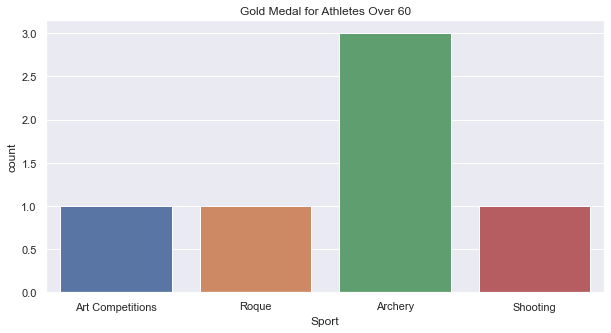

In [30]:
plt.figure(figsize=(10,5))
plt.tight_layout()
sns.countplot(sporting_events)
plt.title("Gold Medal for Athletes Over 60")

In [31]:
# LETS CHECK WHICH COUNTRY WIN THE MOST GOLD MEDALS
goldMedals.Region.value_counts().reset_index()

,index,Region
0,USA,2627
1,Russia,1599
2,Germany,1293
3,UK,657
4,Italy,567
...,...,...
92,Grenada,1
93,Jordan,1
94,Vietnam,1
95,Ivory Coast,1


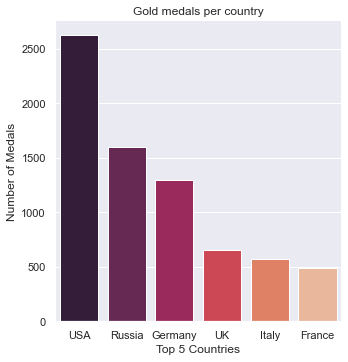

In [32]:
# Lets visualize this data
totalgoldmedal = goldMedals.Region.value_counts().reset_index(name='Medal').head(6)
g = sns.catplot(x='index', y='Medal', data=totalgoldmedal,
             palette='rocket', kind='bar', height=5)
g.set_xlabels("Top 5 Countries")
g.set_ylabels("Number of Medals")
plt.title('Gold medals per country');

In [33]:
# RIO OLYMPICS 2016 
# MOST GOLD MEDALS WON BY TEAMS

top_teams = athletes_df[(athletes_df.Year == 2016) & (athletes_df.Medal == "Gold")].Team
top_teams.value_counts().head()

United States    137
Great Britain     64
Russia            50
Germany           47
China             44
Name: Team, dtype: int64

Text(0.5, 0, 'Countrywise Gold medals for the Year 2016')

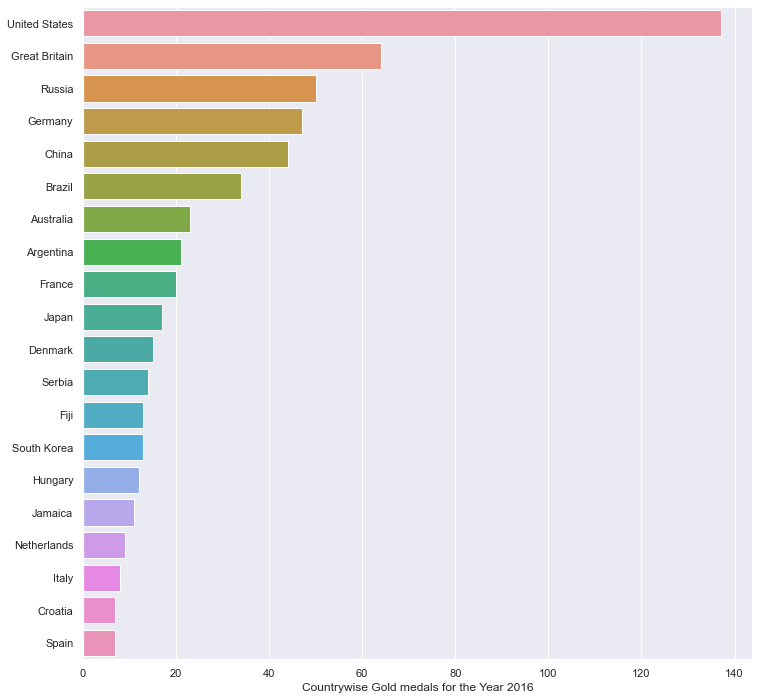

In [34]:
plt.figure(figsize=(12,12))
sns.barplot(x=top_teams.value_counts().head(20), y=top_teams.value_counts().head(20).index)
plt.xlabel("Countrywise Gold medals for the Year 2016")

In [35]:
not_null_medals = athletes_df[(athletes_df['Height'].notnull()) & (athletes_df['Weight'].notnull())]

In [36]:
not_null_medals.head()

,ID,Name,Sex,Age,Height,Weight,Team,NOC,Games,Year,Season,City,Sport,Event,Medal,Region,Notes
0,1,A Dijiang,M,24.0,180.0,80.0,China,CHN,1992 Summer,1992,Summer,Barcelona,Basketball,Basketball Men's Basketball,NaN,China,NaN
1,2,A Lamusi,M,23.0,170.0,60.0,China,CHN,2012 Summer,2012,Summer,London,Judo,Judo Men's Extra-Lightweight,NaN,China,NaN
4,5,Christine Jacoba Aaftink,F,21.0,185.0,82.0,Netherlands,NED,1988 Winter,1988,Winter,Calgary,Speed Skating,Speed Skating Women's 500 metres,NaN,Netherlands,NaN
5,5,Christine Jacoba Aaftink,F,21.0,185.0,82.0,Netherlands,NED,1988 Winter,1988,Winter,Calgary,Speed Skating,"Speed Skating Women's 1,000 metres",NaN,Netherlands,NaN
6,5,Christine Jacoba Aaftink,F,25.0,185.0,82.0,Netherlands,NED,1992 Winter,1992,Winter,Albertville,Speed Skating,Speed Skating Women's 500 metres,NaN,Netherlands,NaN


In [37]:
axxs = px.scatter(not_null_medals, x='Height', y='Weight', color="Sex", hover_data=['Name', 'Sport', 'Team'])
axxs.show()

# Olympics In Physical aspect

## Lightest Athlete Ever to Participate in The Olympics
### Ac to Data the Minimum weight of athlete recorded in olympic history was 25,lets find out about this athlete 

In [38]:
athletes_df.query('Weight == 25')

,ID,Name,Sex,Age,Height,Weight,Team,NOC,Games,Year,Season,City,Sport,Event,Medal,Region,Notes
40849,21049,Choi Myong-Hui,F,14.0,135.0,25.0,North Korea,PRK,1980 Summer,1980,Summer,Moskva,Gymnastics,Gymnastics Women's Individual All-Around,NaN,North Korea,NaN
40850,21049,Choi Myong-Hui,F,14.0,135.0,25.0,North Korea,PRK,1980 Summer,1980,Summer,Moskva,Gymnastics,Gymnastics Women's Team All-Around,NaN,North Korea,NaN
40851,21049,Choi Myong-Hui,F,14.0,135.0,25.0,North Korea,PRK,1980 Summer,1980,Summer,Moskva,Gymnastics,Gymnastics Women's Floor Exercise,NaN,North Korea,NaN
40852,21049,Choi Myong-Hui,F,14.0,135.0,25.0,North Korea,PRK,1980 Summer,1980,Summer,Moskva,Gymnastics,Gymnastics Women's Horse Vault,NaN,North Korea,NaN
40853,21049,Choi Myong-Hui,F,14.0,135.0,25.0,North Korea,PRK,1980 Summer,1980,Summer,Moskva,Gymnastics,Gymnastics Women's Uneven Bars,NaN,North Korea,NaN
40854,21049,Choi Myong-Hui,F,14.0,135.0,25.0,North Korea,PRK,1980 Summer,1980,Summer,Moskva,Gymnastics,Gymnastics Women's Balance Beam,NaN,North Korea,NaN


#### So we can see that Choi Myong-Hui of North Korea is the lightest athlete ever to take part in Olympics, She used to perform Gymnastics and Sadly she never won any Medal in the Olympics.  (Choi Myong-Hui in the pic below)

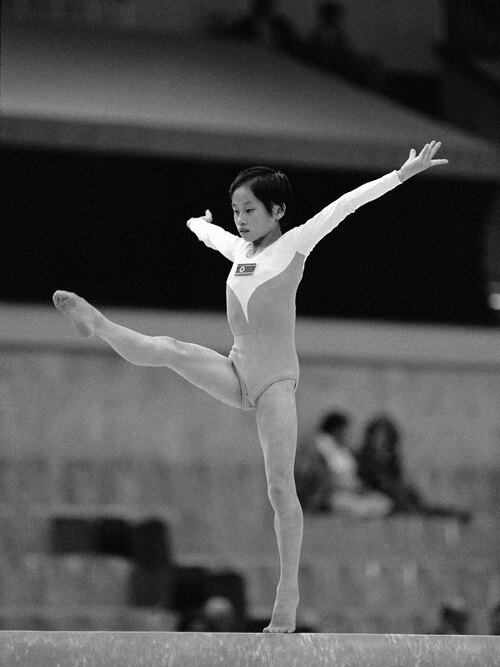

## Heaviest Athlete ever to Participate in The Olympics
### Now lets find who is the heaviest athlete ever to take part in Olympics, The maximum of weight column was 214

In [39]:
athletes_df.query('Weight == 214')

,ID,Name,Sex,Age,Height,Weight,Team,NOC,Games,Year,Season,City,Sport,Event,Medal,Region,Notes
23155,12177,"Ricardo Blas, Jr.",M,21.0,183.0,214.0,Guam,GUM,2008 Summer,2008,Summer,Beijing,Judo,Judo Men's Heavyweight,NaN,Guam,NaN
23156,12177,"Ricardo Blas, Jr.",M,25.0,183.0,214.0,Guam,GUM,2012 Summer,2012,Summer,London,Judo,Judo Men's Heavyweight,NaN,Guam,NaN


#### Ricardo Blas Jr. of the Guam is the heaviest Athlete ever to participate in Olympics, He participated 2 times in Judo Men's Heavyweight division event but was unable to win any medal both the times. (Ricardo Blas Jr. in the Pic below)

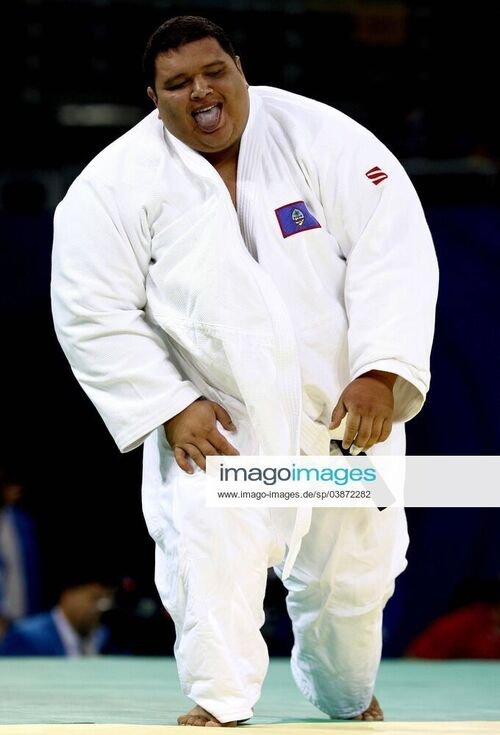

## Tallest Athlete Ever To Participate in The Olympics
### According to putput of the cell 9 the maximum height in the data is 226 cm

In [40]:
athletes_df.query('Height == 226')

,ID,Name,Sex,Age,Height,Weight,Team,NOC,Games,Year,Season,City,Sport,Event,Medal,Region,Notes
265040,132627,Yao Ming,M,20.0,226.0,141.0,China,CHN,2000 Summer,2000,Summer,Sydney,Basketball,Basketball Men's Basketball,NaN,China,NaN
265041,132627,Yao Ming,M,23.0,226.0,141.0,China,CHN,2004 Summer,2004,Summer,Athina,Basketball,Basketball Men's Basketball,NaN,China,NaN
265042,132627,Yao Ming,M,27.0,226.0,141.0,China,CHN,2008 Summer,2008,Summer,Beijing,Basketball,Basketball Men's Basketball,NaN,China,NaN


#### So the tallest athlete ever to play in olympics is Yao Ming From China's Basketball Men's Team, He took part 3 times but failed to secure any medal. (Yao Ming in the Pic below)

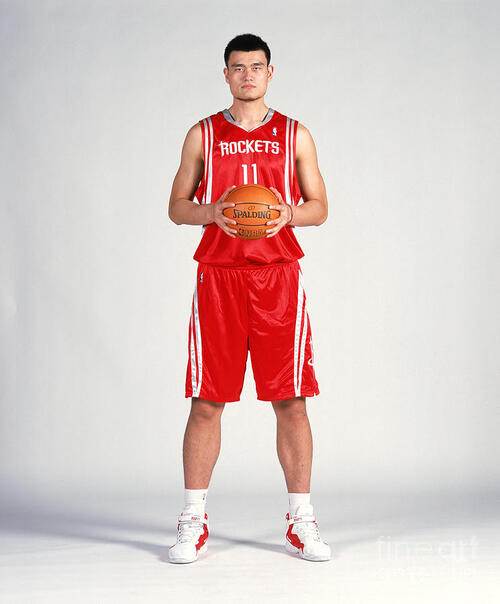

## Shortest Athlete Ever To Participate in The Olympics
### According to putput of the cell 9 the minimum height in the data is 127 cm

In [41]:
athletes_df.query('Height == 127')

,ID,Name,Sex,Age,Height,Weight,Team,NOC,Games,Year,Season,City,Sport,Event,Medal,Region,Notes
29333,15150,Rosario Briones,F,15.0,127.0,42.0,Mexico,MEX,1968 Summer,1968,Summer,Mexico City,Gymnastics,Gymnastics Women's Individual All-Around,NaN,Mexico,NaN
29334,15150,Rosario Briones,F,15.0,127.0,42.0,Mexico,MEX,1968 Summer,1968,Summer,Mexico City,Gymnastics,Gymnastics Women's Team All-Around,NaN,Mexico,NaN
29335,15150,Rosario Briones,F,15.0,127.0,42.0,Mexico,MEX,1968 Summer,1968,Summer,Mexico City,Gymnastics,Gymnastics Women's Floor Exercise,NaN,Mexico,NaN
29336,15150,Rosario Briones,F,15.0,127.0,42.0,Mexico,MEX,1968 Summer,1968,Summer,Mexico City,Gymnastics,Gymnastics Women's Horse Vault,NaN,Mexico,NaN
29337,15150,Rosario Briones,F,15.0,127.0,42.0,Mexico,MEX,1968 Summer,1968,Summer,Mexico City,Gymnastics,Gymnastics Women's Uneven Bars,NaN,Mexico,NaN
29338,15150,Rosario Briones,F,15.0,127.0,42.0,Mexico,MEX,1968 Summer,1968,Summer,Mexico City,Gymnastics,Gymnastics Women's Balance Beam,NaN,Mexico,NaN
164821,82769,Lyton Levison Mphande,M,25.0,127.0,62.0,Malawi,MAW,1988 Summer,1988,Summer,Seoul,Boxing,Boxing Men's Light-Welterweight,NaN,Malawi,NaN


#### There are 2 candidate for the shortest Olympian ever first one is Rosario Briones of Mexico who only participated in 1968 summer olympics as a Gymnast( she took part in 6 different event in Gymnastic)
#### The second one is Lyton Levison Mphande of Malawi, He took part in 1988 summer Olympics as Boxer in Men's Light-Welterweight	event.
#### But none of them was able to secure any medal (unable to find images of both the athletes)

## Now lets check these same aspects for Gold Medalist throughout the history of Olympics

In [42]:
gold_medalist = athletes_df.query("Medal == 'Gold'") #All gold medalist throughout the history of the olympics 


In [43]:
gold_medalist.describe() #this will tell us the maximum minimum mean std of the dataframe

,ID,Age,Height,Weight,Year
count,13372.000000,13224.000000,10539.000000,10254.000000,13372.000000
mean,69358.276473,25.901013,177.898472,74.183879,1973.131618
std,39029.340607,5.892887,11.052521,15.207425,34.179153
min,4.000000,13.000000,136.000000,28.000000,1896.000000
25%,36055.250000,22.000000,170.000000,63.000000,1952.000000
50%,69076.500000,25.000000,178.000000,73.000000,1984.000000
75%,103707.000000,29.000000,185.000000,84.000000,2002.000000
max,135553.000000,64.000000,223.000000,170.000000,2016.000000


## Tallest Gold Medalist in the history of the Olympics
### According to the cell  the Maximum height of a gold medalist is 220cm, Let's check the deatails of the athlete.

In [44]:
gold_medalist.query("Height == 220")

,ID,Name,Sex,Age,Height,Weight,Team,NOC,Games,Year,Season,City,Sport,Event,Medal,Region,Notes
181241,91087,Viktor Aleksandrovich Pankrashkin,M,31.0,220.0,112.0,Soviet Union,URS,1988 Summer,1988,Summer,Seoul,Basketball,Basketball Men's Basketball,Gold,Russia,NaN


#### So the tallest Gold meadalist in the history of the Olympics is Viktor Aleksandrovich Pankrashkin of Russian Basketball Men's team, He won his gold medal in the 1988 summer his Height is Whopping 7.2 ft.  ( Pankrashkin in the pic below)

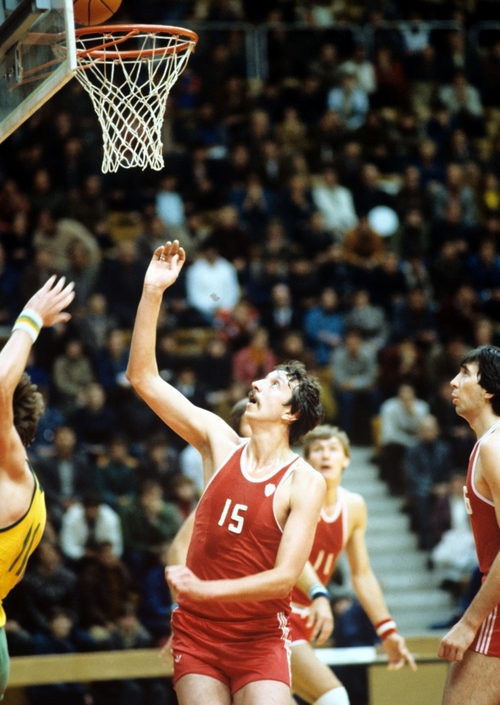

## Shortest Gold Medalist in the history of the Olympics¶
### According to the cell 43  the minimum height of a gold medalist is 136cm, Let's check the deatails of the athlete.

In [45]:
gold_medalist.query("Height == 136")

,ID,Name,Sex,Age,Height,Weight,Team,NOC,Games,Year,Season,City,Sport,Event,Medal,Region,Notes
69216,35292,Mariya Yevgenyevna Filatova (-Kurbatova),F,14.0,136.0,30.0,Soviet Union,URS,1976 Summer,1976,Summer,Montreal,Gymnastics,Gymnastics Women's Team All-Around,Gold,Russia,NaN
69222,35292,Mariya Yevgenyevna Filatova (-Kurbatova),F,19.0,136.0,30.0,Soviet Union,URS,1980 Summer,1980,Summer,Moskva,Gymnastics,Gymnastics Women's Team All-Around,Gold,Russia,NaN
143279,71914,Lu Li,F,15.0,136.0,30.0,China,CHN,1992 Summer,1992,Summer,Barcelona,Gymnastics,Gymnastics Women's Uneven Bars,Gold,China,NaN


####  Lu Li of China and Mariya Yevgenyevna Filatova of Russia ( then Soviet Union)  are the shortest Athlete ever to win a gold medal both have the same Height of 4.4ft.
####  Mariya Yevgenyevna Filatova Won Gold medal twice first in 1976 summer olympics in Gymnastics Women's Team All-Around event and other one in 1980 summer olympics in the same event.
#### Lu li won her only gold in 1992 summer olympics in Gymnastics Women's Uneven Bars event.   
#####                                       (Lu Li in the pic 1)              (Maria Filatova in the 2nd one)

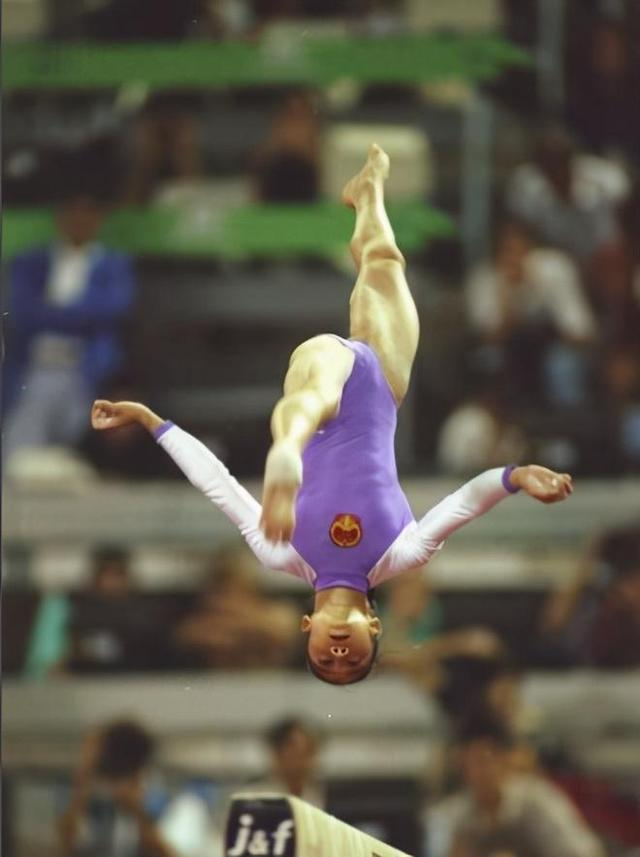

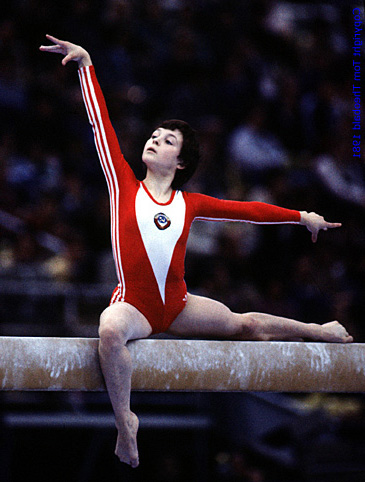

## Heaviest Gold Medalist in the history of the Olympics¶¶
### According to the cell 43 the maximum weight of a gold medalist is 170kg, Let's check the deatails of this athlete.

In [46]:
gold_medalist.query("Weight == 170")

,ID,Name,Sex,Age,Height,Weight,Team,NOC,Games,Year,Season,City,Sport,Event,Medal,Region,Notes
39181,20144,Andrey Ivanovich Chemerkin,M,24.0,183.0,170.0,Russia,RUS,1996 Summer,1996,Summer,Atlanta,Weightlifting,Weightlifting Men's Super-Heavyweight,Gold,Russia,NaN


#### Andrey Ivanovich Chemerkin	of Russia is the heaviest athlete ever to win a gold medal in the Olympics, he won this gold medal in the Weightliftng Men's Super-Heavyweight	event in 1996summer Olympics. ( Andrey Ivanovich Chemerkin	in the pic below )

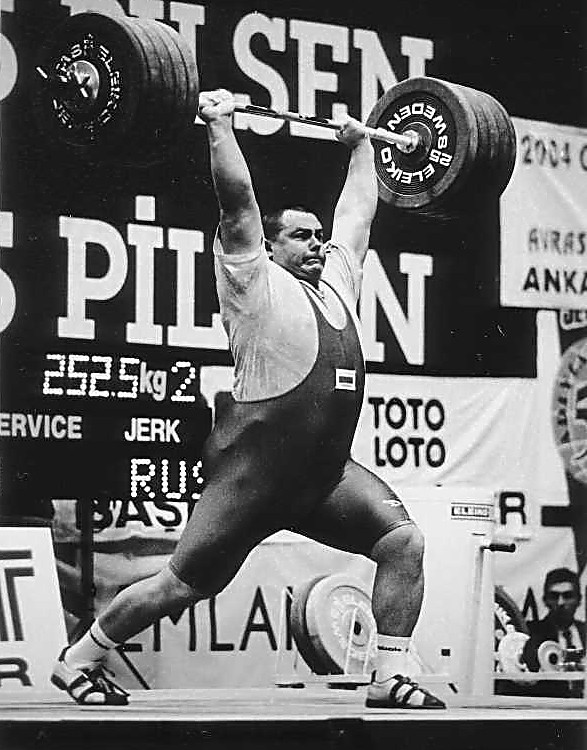

## Lightest Gold Medalist in the history of the Olympics¶¶
### According to the cell 48 the minimum weight of a gold medalist is 28kg, Let's check the deatails of this athlete.

In [47]:
gold_medalist.query("Weight == 28")

,ID,Name,Sex,Age,Height,Weight,Team,NOC,Games,Year,Season,City,Sport,Event,Medal,Region,Notes
256837,128605,Wang Xin (Ruoxue-),F,15.0,137.0,28.0,China,CHN,2008 Summer,2008,Summer,Beijing,Diving,Diving Women's Synchronized Platform,Gold,China,NaN


#### Wang Xin of China is the Lightest Gold medalist ever, She won her only gold In Diving Women's Synchronized Platform event at 2008 summer olympics.       ( Wang Xin in the pic below)

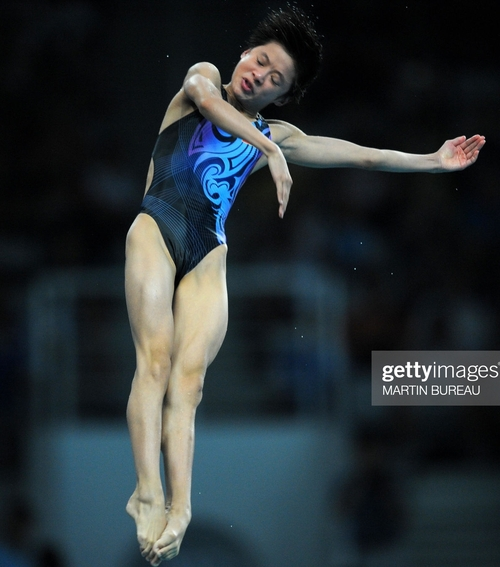

In [48]:
indian_gold = gold_medalist[gold_medalist.Team == 'India'].Sport.unique()
indian_gold

array(['Hockey', 'Shooting', 'Alpinism'], dtype=object)

### Till 2016 rio Olympics india had gold medals in only two sports field Hockey and Shooting.
### India won the field Hockey event in seven out of eight Olympics from 1928 to 1964.
### And by bagging a gold medal in shooting in the summer event of 2008 Beijing Olympics Abhinav Bindra became India's first individual Olympic gold medalist, 
### And this year after almost 13 years neeraj chopra became the 2nd individual Olympic gold medalist for india and first gold medalist in athletics, and he added another sport Javeline to this list .

#### Let's filter the main dataframe into a dataframe of all medalist

In [69]:
medalist_df = athletes_df[athletes_df['Medal'].notnull()]
medalist_df.head()

,ID,Name,Sex,Age,Height,Weight,Team,NOC,Games,Year,Season,City,Sport,Event,Medal,Region,Notes
3,4,Edgar Lindenau Aabye,M,34.0,NaN,NaN,Denmark/Sweden,DEN,1900 Summer,1900,Summer,Paris,Tug-Of-War,Tug-Of-War Men's Tug-Of-War,Gold,Denmark,NaN
37,15,Arvo Ossian Aaltonen,M,30.0,NaN,NaN,Finland,FIN,1920 Summer,1920,Summer,Antwerpen,Swimming,Swimming Men's 200 metres Breaststroke,Bronze,Finland,NaN
38,15,Arvo Ossian Aaltonen,M,30.0,NaN,NaN,Finland,FIN,1920 Summer,1920,Summer,Antwerpen,Swimming,Swimming Men's 400 metres Breaststroke,Bronze,Finland,NaN
40,16,Juhamatti Tapio Aaltonen,M,28.0,184.0,85.0,Finland,FIN,2014 Winter,2014,Winter,Sochi,Ice Hockey,Ice Hockey Men's Ice Hockey,Bronze,Finland,NaN
41,17,Paavo Johannes Aaltonen,M,28.0,175.0,64.0,Finland,FIN,1948 Summer,1948,Summer,London,Gymnastics,Gymnastics Men's Individual All-Around,Bronze,Finland,NaN


In [50]:
medal_won = medalist_df.Team.value_counts().reset_index() #changing in dataframe
medal_won

,index,Team
0,United States,5219
1,Soviet Union,2451
2,Germany,1984
3,Great Britain,1673
4,France,1550
...,...,...
493,Frimousse,1
494,Monaco,1
495,Turquoise-1,1
496,Nadine,1


In [51]:
medal_won= medal_won.rename(columns={"Team":"Medals_no"}) # naming the columns right 

In [52]:
medal_won = medal_won.rename(columns={"index":"Team"})


In [53]:
medal_won

,Team,Medals_no
0,United States,5219
1,Soviet Union,2451
2,Germany,1984
3,Great Britain,1673
4,France,1550
...,...,...
493,Frimousse,1
494,Monaco,1
495,Turquoise-1,1
496,Nadine,1


In [54]:
total_participants = athletes_df.Team.value_counts().reset_index()
total_participants

,index,Team
0,United States,17847
1,France,11988
2,Great Britain,11404
3,Italy,10260
4,Germany,9326
...,...,...
1179,Briar,1
1180,Hannover,1
1181,Nan-2,1
1182,Brentina,1


In [55]:
#renaming the columns
total_participants = total_participants.rename(columns={"Team": "Total_part"})
total_participants = total_participants.rename(columns={"index":"Team"})

##### Disclaimer : This data is of individual athletes so medal no. may vary from official record because officially medal won by a team counted as 1 here it counts for every single individual.

In [56]:
team_performance = pd.merge(total_participants, medal_won, how="inner", on="Team")
team_performance

,Team,Total_part,Medals_no
0,United States,17847,5219
1,France,11988,1550
2,Great Britain,11404,1673
3,Italy,10260,1527
4,Germany,9326,1984
...,...,...,...
493,Femur-1,1,1
494,Carabinier-15,1,1
495,Nadine,1,1
496,Turquoise-1,1,1


### Scatter plot for performance rate 

In [57]:
tp = px.scatter(team_performance, x='Total_part', y='Medals_no', hover_data=['Team', 'Total_part', 'Medals_no'],
               labels={
                   "Total_part": "Total Participants",
                   "Medals_no": "Total Medals won"
               })
tp.show()

In [71]:
team_performance = team_performance[team_performance['Total_part'] > 100]

In [82]:
# Performance rate is calulated by Dividing Total medals won by total participants
team_performance['Performance_rate'] = team_performance['Medals_no'] / team_performance['Total_part']
top_10_performance = team_performance.head(10) 


<ipython-input-82-eacd5c7000d1>:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [81]:
fig = px.bar(top_10_performance, x='Team', y='Performance_rate')
fig.show()

In [65]:
w = round(gold_medalist['Weight'].mean(), 2) #Average Weight of a Gold medalist
print(w,'Kg')

74.18 Kg


In [68]:
h = round(gold_medalist['Height'].mean(), 2) #Average Height of a Gold Medalist
print(h,'cm', 'or', round(h/30.48, 2), 'feet')

177.9 cm or 5.84 feet


In [84]:
#thats it for now i will add more facts and stats as i will get more ideas